# Leaf Lesion Detector

This is a document that covers the what, and how of the leaf lesion detector application developed between January and May 2023 at the American Family Insurance Data Science Institute by [Iain McConnell](https://www.linkedin.com/in/iain-mcconnell/) and [Arjun S. Iyer](https://www.linkedin.com/in/iyer-arjun/).

## What?

[Leaf Lesion detector](https://leaflesiondetector.streamlit.app/) (Access by invite) is a web application that detects lesions on a tomato leaf, furthering categorizing them by size and extracting further data and insights from an individual leaf or a set of lesioned leaves.

This application was developed in collaboration with the [Barak Lab](https://barak-lab.russell.wisc.edu/) at the University of Wisconsin-Madison

## How?

This section is an in depth step by step description of the code within the `leaflesiondetectior` package.

### External packages used:

- PIL
- skimage 
- scipy
- numpy

In [50]:
import numpy as np
from PIL import Image, ImageDraw, ImageEnhance
from PIL import ImageFilter
import json
import time
from leaflesiondetector.leaf import Leaf
from skimage import measure
from scipy import ndimage

Let us start with the dataclasses in:

`leaflesiondetector.leaf`

- `reference` indicates if a reference object is included in the image.

- `labeled_pixels` is a 2D array that indicates the lesion class that the pixel belongs to.

- `lesion_class_map` is a dictionary that maps the lesion class number to lesion size (in pixels by default or in $mm^2$ if a reference object is included).

In [51]:
from typing import List
from PIL import Image
from dataclasses import dataclass, field


@dataclass
class Leaf:
    key: str
    name: str
    img: Image
    reference: bool = False
    reference_area: float = 0
    background_colour: str = ""
    leaf_binary: Image = None
    lesion_binary: Image = None
    reference_binary: Image = None
    leaf_area: int = 0
    lesion_area: int = 0
    lesion_area_percentage: float = 0
    lesion_area_mm2: float = 0
    run_time: float = 0
    minimum_lesion_area_value: int = 0
    modified_image: Image = None
    average_lesion_size: float = 0
    num_lesions: int = 0
    min_lesion_size: float = 0
    max_lesion_size: float = 0
    labeled_pixels: list = field(default_factory=list)
    lesion_class_map: dict = field(default_factory=dict)
    lesion_size_threshold: float = 0.01

    def __lt__(self, other):
        return self.lesion_area_percentage < other.lesion_area_percentage


@dataclass
class LeafList:
    leaves: List[Leaf] = field(default_factory=list)

And a look at `settings.json` :

```
{
    "background_colour": "Black",
    "input_folder_path": "./input_images",
    "output_folder_path": "./results",
    "reference_area_mm": 251.930676616,
    "median_blur_size": {
        "leaf": 13,
        "lesion": 5,
        "reference": 25
    },
    "Black": {
        "low_intensity": 120,
        "high_intensity": 140,
        "leaf_area": {
            "min_hue": 35,
            "max_hue": 100,
            "min_saturation": 0,
            "max_saturation": 255,
            "min_value": 60,
            "max_value": 255,
            "level": 50
        },
        "lesion_area": {
            "min_hue": 35,
            "max_hue": 100,
            "min_saturation": 0,
            "max_saturation": 255,
            "min_value": 130,
            "max_value": 255
        },
        "reference_area": {
            "min_hue": 150,
            "max_hue": 255,
            "min_saturation": 90,
            "max_saturation": 255,
            "min_value": 90,
            "max_value": 255
        }
    },
    "White": {
        "low_intensity": 110,
        "high_intensity": 130,
        "leaf_area": {
            "min_hue": 35,
            "max_hue": 100,
            "min_saturation": 25,
            "max_saturation": 255,
            "min_value": 0,
            "max_value": 255,
            "level": 170
        },
        "lesion_area": {
            "min_hue": 35,
            "max_hue": 100,
            "min_saturation": 25,
            "max_saturation": 255,
            "min_value": 130,
            "max_value": 255
        },
        "reference_area": {
            "min_hue": 150,
            "max_hue": 255,
            "min_saturation": 25,
            "max_saturation": 255,
            "min_value": 90,
            "max_value": 255
        }
    }
}
```

In [52]:
# Read in settings from JSON file
with open("src/leaflesiondetector/settings.json") as f:
    settings = json.load(f)

Now let us understand the process of detecting lesion in the following leaf and understand how the code works along the way. The pink object in the image is a reference object the size of a dime and colored pink for identification purposes.

### Step 1: Let's make a leaf

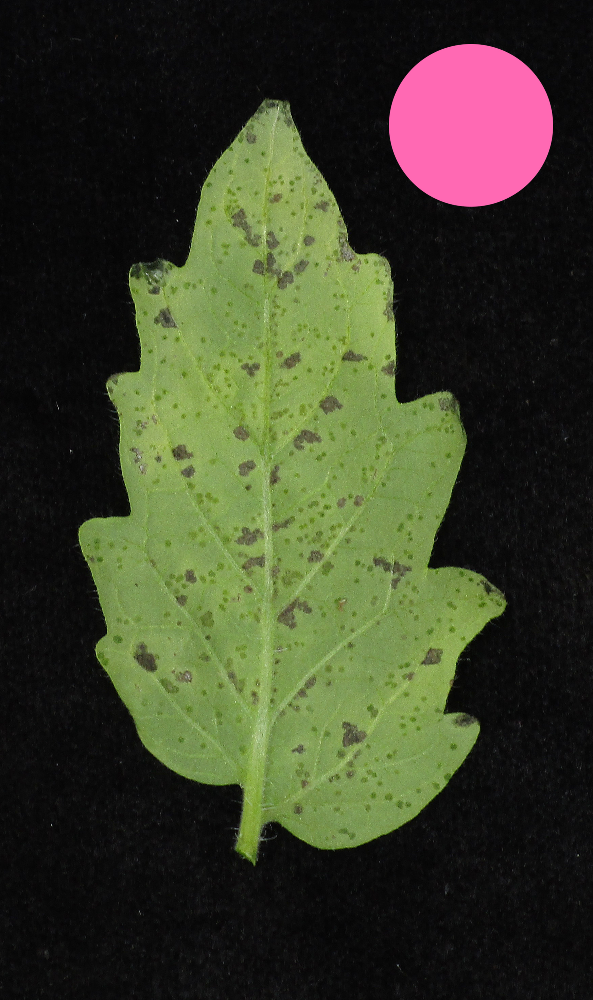

In [53]:
with Image.open("img/black_edit1.jpeg") as img:
    my_leaf = Leaf(
            f"{'black_edit1.jpeg'}_{int(time.time_ns())}",
            'black_edit1.jpeg',
            img.copy(),
        )
    
my_leaf.modified_image = my_leaf.img.copy()
display(my_leaf.modified_image)

### Step 2.1: What color is the background?

In [54]:
print("Background color before: ", my_leaf.background_colour)
def background_detector(leaf: Leaf):
    hsv_img = leaf.img.convert("HSV")
    hsv = np.array(hsv_img)
    value = hsv[:, :, 2] < 70

    if np.sum(value) > (hsv.shape[0] * hsv.shape[1] * 0.4):
        leaf.background_colour = "Black"
    else:
        leaf.background_colour = "White"

background_detector(my_leaf)
print("Background color after: ", my_leaf.background_colour)

Background color before:  
Background color after:  Black


In [55]:
# Set to high intensity detection
my_leaf.minimum_lesion_area_value = settings[my_leaf.background_colour][
                    "high_intensity"
                ]

### Step 2.2: Is there a reference object? Is yes, where is it?

In [56]:
print(f"Is there a reference object? {my_leaf.reference}, What is the area? {my_leaf.reference_area}, Is there an image? {my_leaf.reference_binary}")
def append_reference_area_binary(leaf: Leaf) -> None:
    """
    Takes a leaf object as input and saves a binary image with the reference area highlighted in white, to the object.
    """

    hsv_img = leaf.img.convert("HSV")
    hsv = np.array(hsv_img)

    # Create a mask of pink regions
    hues = hsv[:, :, 0] > settings[leaf.background_colour]["reference_area"]["min_hue"]
    saturation = (
        hsv[:, :, 1]
        > settings[leaf.background_colour]["reference_area"]["min_saturation"]
    )
    values = (
        hsv[:, :, 2] > settings[leaf.background_colour]["reference_area"]["min_value"]
    )

    if np.sum(hues * saturation * values) > (hsv.shape[0] * hsv.shape[1] * 0.01):
        leaf.reference = True
    else:
        leaf.reference = False
        return

    new_img = Image.fromarray(np.uint8(hues * saturation * values * 255))

    # Remove noise
    new_img = new_img.filter(
        ImageFilter.MedianFilter(settings["median_blur_size"]["reference"])
    )

    leaf.reference_binary = new_img.convert("RGB").copy()

    # Mark the reference area in the image and save calculated values to the leaf object
    pixels = leaf.modified_image.load()
    reference_mask = leaf.reference_binary.load()
    for i in range(leaf.img.size[0]):  # for every pixel:
        for j in range(leaf.img.size[1]):
            if reference_mask[i, j] == (255, 255, 255):  # if white in reference mask
                leaf.reference_area += 1
                pixels[i, j] = (0, 255, 0)  # change to green

append_reference_area_binary(my_leaf)
print(f"Is there a reference object? {my_leaf.reference}, What is the area? {my_leaf.reference_area}, Is there an image? {my_leaf.reference_binary}")

Is there a reference object? False, What is the area? 0, Is there an image? None
Is there a reference object? True, What is the area? 181776, Is there an image? <PIL.Image.Image image mode=RGB size=1745x2939 at 0x17F30EBE0>


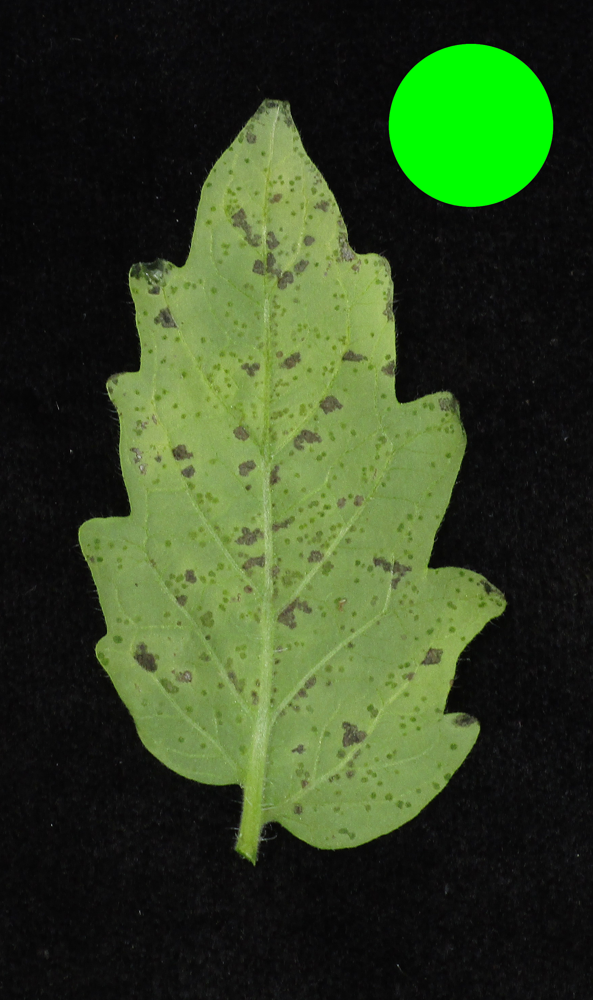

In [57]:
display(my_leaf.modified_image)

### Step 3: Where's the leaf?

In [58]:
print(f"What is the leaf area? {my_leaf.leaf_area}, Is there an image? {my_leaf.leaf_binary}")
def append_leaf_area_binary(leaf: Leaf) -> None:
    """
    Takes a leaf object as input and saves a binary image with the leaf area highlighted in white, to the object.
    """

    hsv_img = leaf.img.convert("HSV")
    hsv = np.array(hsv_img)

    # Create a mask of the estimated leaf region using image thresholding
    min_hues = hsv[:, :, 0] > settings[leaf.background_colour]["leaf_area"]["min_hue"]
    max_hues = hsv[:, :, 0] < settings[leaf.background_colour]["leaf_area"]["max_hue"]
    saturation = (
        hsv[:, :, 1] > settings[leaf.background_colour]["leaf_area"]["min_saturation"]
    )
    values = hsv[:, :, 2] > settings[leaf.background_colour]["leaf_area"]["min_value"]

    new_img = Image.fromarray(np.uint8(min_hues * max_hues * saturation * values * 255))

    # Apply contouring to mark the leaf boundary
    image_gray = new_img.convert("L")

    enhancer = ImageEnhance.Contrast(image_gray)
    image_gray = enhancer.enhance(2)

    level = settings[leaf.background_colour]["leaf_area"]["level"]
    contours = (
        measure.find_contours(np.array(image_gray), level=level - 10)
        + measure.find_contours(np.array(image_gray), level=level)
        + measure.find_contours(np.array(image_gray), level=level + 10)
    )

    new_img = Image.new("RGB", (image_gray.size[0], image_gray.size[1]), color="black")
    draw_on_white = ImageDraw.Draw(new_img)
    draw_on_img = ImageDraw.Draw(leaf.modified_image)

    for contour in contours:
        x_coords = [coord[0] for coord in contour]
        leftmost_x = min(x_coords)
        rightmost_x = max(x_coords)
        width = rightmost_x - leftmost_x
        if width >= image_gray.size[1] / 4:
            contour_points = (
                np.flip(contour, axis=1).flatten().tolist()
            )  # Convert contour to list of points
            draw_on_white.line(contour_points, fill="blue", width=2)
            draw_on_img.line(contour_points, fill="blue", width=5)
    
    # Floodfill the image to remove any noise within the boundary
    ImageDraw.floodfill(
        new_img, (new_img.size[0] / 2, new_img.size[1] / 2), (255, 255, 255)
    )

    # Save calculated values to the leaf object
    leaf.leaf_area = np.sum(np.asarray(new_img.convert("1")))
    leaf.leaf_area = (
        leaf.leaf_area * settings["reference_area_mm"] / leaf.reference_area
        if leaf.reference
        else leaf.leaf_area
    )
    leaf.leaf_binary = new_img.convert("RGB").copy()

append_leaf_area_binary(my_leaf)
print(f"What is the leaf area? {my_leaf.leaf_area}, Is there an image? {my_leaf.leaf_binary}")

What is the leaf area? 0, Is there an image? None
What is the leaf area? 2361.5479582984226, Is there an image? <PIL.Image.Image image mode=RGB size=1745x2939 at 0x1580BE4F0>


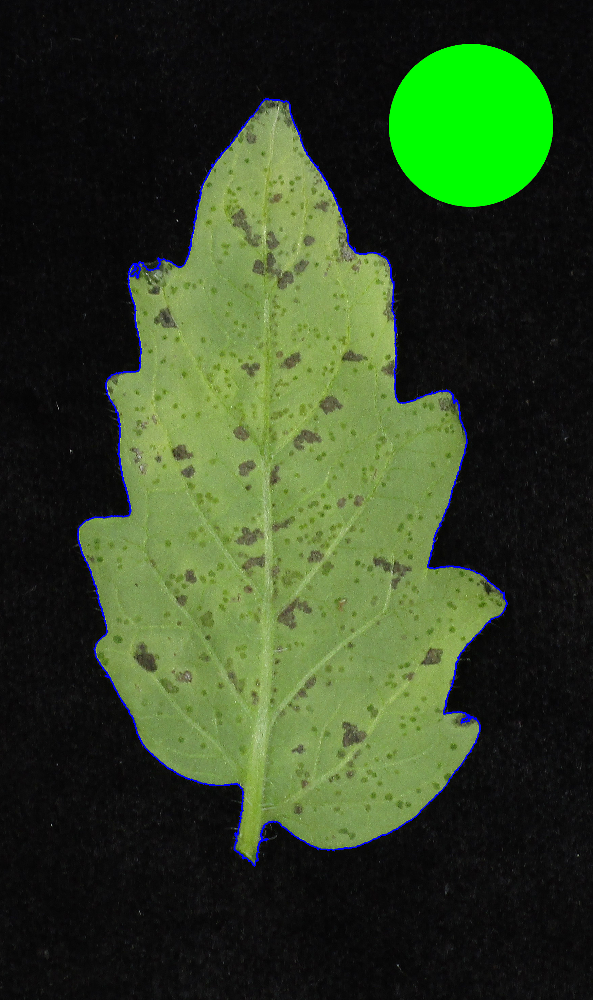

In [59]:
display(my_leaf.modified_image)

### Step 4: Where are the lesions?

In [60]:
print(f"What is the area? {my_leaf.lesion_area}, Is there an image? {my_leaf.lesion_binary}")
def value_to_color(value, vmin, vmax):
    """Convert a value to an RGB color tuple based on its position between vmin and vmax."""
    vrange = vmax - vmin
    if vrange == 0:
        return (0, 0, 0)
    else:
        v = (value - vmin) / vrange
        return (255, int(255 * (1.0 - v)), 0)
    
def segment_lesions(leaf: Leaf):
    """
    This function segments the lesions in the image.
    """

    # Segment individual regions from the binary
    lesion_binary = np.asarray(leaf.lesion_binary)
    lesion_binary = ~lesion_binary
    labeled, num_objects = ndimage.label(lesion_binary)

    # Filter the lesions based on the size threshold
    leaf.labeled_pixels = labeled
    classes, sizes = np.unique(labeled, return_counts=True)
    if leaf.reference:
        leaf.lesion_class_map = {
            int(k): float(v)
            for k, v in zip(
                classes, sizes * settings["reference_area_mm"] / leaf.reference_area
            )
            if v > leaf.lesion_size_threshold
        }
    else:
        leaf.lesion_size_threshold = (
            10.0 if leaf.lesion_size_threshold == 0.01 else leaf.lesion_size_threshold
        )
        leaf.lesion_class_map = {
            int(k): float(v)
            for k, v in zip(classes, sizes)
            if v > leaf.lesion_size_threshold
        }

    # Remove segmented classes 0 and 1 since they represent the background and the leaf
    leaf.lesion_class_map.pop(0)
    leaf.lesion_class_map.pop(1)

    # Create a color map for the lesions
    class_color = {}
    for class_value in leaf.lesion_class_map.keys():
        class_color[class_value] = value_to_color(
            leaf.lesion_class_map[class_value],
            min(leaf.lesion_class_map.values()),
            max(leaf.lesion_class_map.values()),
        )

    # Create a new image with the lesions highlighted
    leaf_pixels = leaf.leaf_binary.load()
    leaf.lesion_area = 0
    for y in range(leaf.labeled_pixels.shape[0]):
        for x in range(leaf.labeled_pixels.shape[1]):
            if (labeled[y, x] not in class_color.keys()) or (
                leaf_pixels[x, y] == (0, 0, 0)
            ):
                continue
            leaf.modified_image.putpixel((x, y), class_color[labeled[y, x]])
            leaf.lesion_area += 1

    # Save calculated values to the leaf object
    leaf.lesion_area = (
        (leaf.lesion_area * settings["reference_area_mm"]) / leaf.reference_area
        if leaf.reference
        else leaf.lesion_area
    )
    leaf.lesion_area_percentage = 100 * leaf.lesion_area / leaf.leaf_area

    leaf.average_lesion_size = np.mean(list(leaf.lesion_class_map.values()))
    leaf.min_lesion_size = min(list(leaf.lesion_class_map.values()))
    leaf.max_lesion_size = max(list(leaf.lesion_class_map.values()))
    leaf.num_lesions = len(list(leaf.lesion_class_map.values()))

def append_lesion_area_binary(leaf: Leaf) -> None:
    """
    Takes a leaf object as input and saves a binary image with the non lesion area highlighted in white, to the object.
    i.e. the lesion area is black.
    """

    hsv_img = leaf.img.convert("HSV")
    hsv = np.array(hsv_img)

    # Create a mask of the estimated lesion region using image thresholding
    min_hues = hsv[:, :, 0] > settings[leaf.background_colour]["lesion_area"]["min_hue"]
    max_hues = hsv[:, :, 0] < settings[leaf.background_colour]["lesion_area"]["max_hue"]
    saturation = (
        hsv[:, :, 1] > settings[leaf.background_colour]["lesion_area"]["min_saturation"]
    )
    values = hsv[:, :, 2] > leaf.minimum_lesion_area_value

    leaf.lesion_binary = Image.fromarray(
        np.uint8(min_hues * max_hues * saturation * values * 255)
    )

    image_gray = leaf.leaf_binary.copy().convert("L")

    # Enhance contrast and use contouring to mark the estimated leaf boundary to ensure lesions on the leaf boundary are included
    enhancer = ImageEnhance.Contrast(image_gray)
    image_gray = enhancer.enhance(2)

    level = settings[leaf.background_colour]["lesion_area"]["level"]
    contours = (
        measure.find_contours(np.array(image_gray), level=level - 10)
        + measure.find_contours(np.array(image_gray), level=level)
        + measure.find_contours(np.array(image_gray), level=level + 10)
    )

    draw = ImageDraw.Draw(leaf.lesion_binary)

    for contour in contours:
        x_coords = [coord[0] for coord in contour]
        leftmost_x = min(x_coords)
        rightmost_x = max(x_coords)
        width = rightmost_x - leftmost_x
        if width >= image_gray.size[1] / 4:
            contour_points = (
                np.flip(contour, axis=1).flatten().tolist()
            )  # Convert contour to list of points
            draw.line(contour_points, fill="white", width=10)
    
    # Segment individual lesions
    segment_lesions(leaf)

append_lesion_area_binary(my_leaf)
print(f"What is the area? {my_leaf.lesion_area}, Is there an image? {my_leaf.lesion_binary}")

What is the area? 0, Is there an image? None
What is the area? 270.83212987544573, Is there an image? <PIL.Image.Image image mode=L size=1745x2939 at 0x17F300EE0>


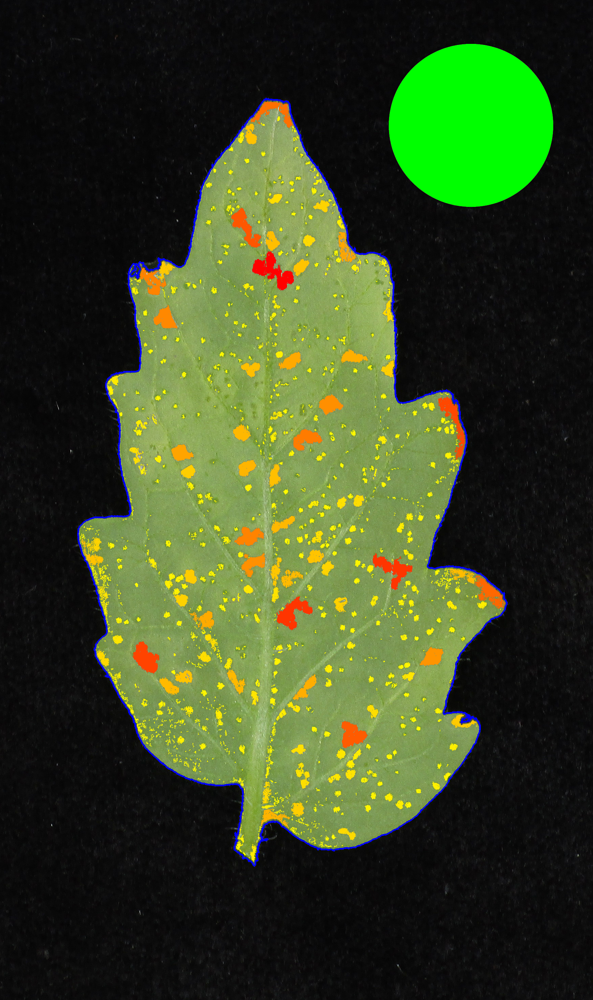

In [61]:
display(my_leaf.modified_image)

Now that we have seen the code used for the primary functionality of the application, let us look at the code used for the user interface. A low code Python based front end tool: [Streamlit](https://streamlit.io/) is used to achieve this. Please refer to https://docs.streamlit.io/library/get-started to gain a basic understanding of Streamlit.

### Setup

- The base script is `Lesion_Detection.py` and it is the script that is run to start the application
- The primary helper is `ui_functions.py`
- The additional pages of the application are stored in `pages/`
- `vis_data_pipeline.py` is a helper function for the page `Visualization.py`

### Primary functions in `ui_functions.py`

1. `save_uploaded_files()` : Saves the uploaded files to the `input_images` folder
2. `process_uploaded_images()` : Processes the uploaded images and saves the results to the `results` folder
3. `download_results()`: Enables a download option by zipping all the results into a downloadable file and attaching it to a download button.
4. `display_results()`: Displays the results in the form of images, plots, and text.

### How it works

Streamlit reruns the main script every time a component is interacted with on the page. This means `Lesion_Detection.py` is rerun every time a button is clicked or elements on the page are interacted with. The same applies for all the other pages in the `pages/` folder.

The purpose of `ui_functions.py` and `vis_data_pipeline.py` is to help make the code in `Lesion_Detection.py` and `Visualization.py` more readable and easier to understand.